<a id="some_id"></a>

# How to tell a Story with Data

TOC:
1. [Project description](#first-bullet)
2. [Research information](#second-bullet)
3. [Data preprocessing](#third-bullet)
4. [Data Analysis](#fouth-bullet)
5. [Detailed research: a coffe shop opening](#fifth-bullet)
6. [The presentation](#sixes-bullet)


## 1. Project description  <a class="anchor" id="first-bullet"></a>

Investors from the 'Take My Money' fund are considering the possibility of opening a food service facility. The investors lack experience in implementing such projects, and at the moment, they have not decided what type of place it will be: a cafe, restaurant, pizzeria, pub, or bar. There is also no certainty regarding aspects such as the future location, menu composition, and pricing.

The aim of this project is to research the city market in order to identify interesting features and present the obtained results, which will help the investors choose a suitable location in the future.

The subject of the study was a dataset of food service facilities in Moscow, compiled based on data from Yandex Maps and Yandex Business for the summer of 2022. The information provided in Yandex Business may have been added by users or sourced from publicly available data. It is purely for reference purposes.

##  2. Research information  <a class="anchor" id="second-bullet"></a>

In [1]:
import pandas as pd
import scipy.stats as stats
import datetime as dt
import time
import numpy as np
import matplotlib.pyplot as plt
import numpy as np
from numpy import median
import math as mth
import seaborn as sns
from scipy import stats as st
import plotly.express as px
import folium

In [2]:
data = pd.read_csv('moscow_places.csv')
data.head()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0


In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


In [4]:
print('Categories of food service facilities:', data['category'].unique())

Categories of food service facilities: ['кафе' 'ресторан' 'кофейня' 'пиццерия' 'бар,паб' 'быстрое питание'
 'булочная' 'столовая']


In [5]:
print('Administrative districts:', data['district'].unique())

Administrative districts: ['Северный административный округ'
 'Северо-Восточный административный округ'
 'Северо-Западный административный округ'
 'Западный административный округ' 'Центральный административный округ'
 'Восточный административный округ' 'Юго-Восточный административный округ'
 'Южный административный округ' 'Юго-Западный административный округ']


In [6]:
print('The price categories.:', data['price'].unique())

The price categories.: [nan 'выше среднего' 'средние' 'высокие' 'низкие']


**Conclusion**

The information is provided for 8406 food service facilities across all administrative districts of Moscow. For each of these food service facilities, there is information about the name, category, address (including geographic coordinates on the map), administrative district, and network affiliation. However, the information describing the pricing category of food service facilities (the price category, the number with an assessment of the average check, the number with an assessment of a single cup of cappuccino) is not provided in full, as well as the number of seats.

##  3. Data preprocessing  <a class="anchor" id="third-bullet"></a>

### 3.1. Adding the necessary columns <a class="anchor" id="third-first-bullet"></a>

In [7]:
# adding a 'street' column with street names from the address column
data['street'] = data['address'].str.split(', ').str[1]

# creating a column called "is_24_7" indicating that the establishment operates daily and around the clock (24/7):
# boolean value True — if the establishment operates daily and around the clock;
# boolean value False — otherwise.
data['is_24_7'] = data['hours'].str.contains('ежедневно, круглосуточно', case=False) 
data.head(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
0,WoWфли,кафе,"Москва, улица Дыбенко, 7/1",Северный административный округ,"ежедневно, 10:00–22:00",55.878494,37.478860,5.0,NaN,NaN,NaN,NaN,0,NaN,улица Дыбенко,False
1,Четыре комнаты,ресторан,"Москва, улица Дыбенко, 36, корп. 1",Северный административный округ,"ежедневно, 10:00–22:00",55.875801,37.484479,4.5,выше среднего,Средний счёт:1500–1600 ₽,1550.0,NaN,0,4.0,улица Дыбенко,False
2,Хазри,кафе,"Москва, Клязьминская улица, 15",Северный административный округ,"пн-чт 11:00–02:00; пт,сб 11:00–05:00; вс 11:00...",55.889146,37.525901,4.6,средние,Средний счёт:от 1000 ₽,1000.0,NaN,0,45.0,Клязьминская улица,False
3,Dormouse Coffee Shop,кофейня,"Москва, улица Маршала Федоренко, 12",Северный административный округ,"ежедневно, 09:00–22:00",55.881608,37.488860,5.0,NaN,Цена чашки капучино:155–185 ₽,NaN,170.0,0,NaN,улица Маршала Федоренко,False
4,Иль Марко,пиццерия,"Москва, Правобережная улица, 1Б",Северный административный округ,"ежедневно, 10:00–22:00",55.881166,37.449357,5.0,средние,Средний счёт:400–600 ₽,500.0,NaN,1,148.0,Правобережная улица,False


### 3.2. Checking for missing values  <a class="anchor" id="third-second-bullet"></a>

In [8]:
data.isnull().sum()

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                3611
street                  0
is_24_7               536
dtype: int64

In [9]:
# missing values for the column 'is_24_7' 
zero_hours = data[data['is_24_7'].isna()]
zero_hours.isnull().sum()

name                   0
category               0
address                0
district               0
hours                536
lat                    0
lng                    0
rating                 0
price                531
avg_bill             528
middle_avg_bill      530
middle_coffee_cup    535
chain                  0
seats                236
street                 0
is_24_7              536
dtype: int64

**Conclusions**
1. Out of 536 food service facilities for which there is no information about operating hours, there is practically no information available about prices. Currently, I will not delete these entries as they characterize the distribution of food service facilities in Moscow.

2. In the entire dataset, there are too many missing values in information that characterizes the price range of food service facilities, so I will not delete entire entries. We will replace them with median values for 'middle_avg_bill' and 'middle_coffee_cup' based on the category to which the food service facility belongs and the price category.

### 3.3. Checking for duplicates  <a class="anchor" id="third-third-bullet"></a>

In [10]:
# Checking for duplicates
print('Number duplicates', data.duplicated().sum())

Number duplicates 0


In [11]:
print('Number of duplicate establishment names', data['name'].duplicated().sum())

Number of duplicate establishment names 2792


### 3.4. Filling and removing missing values  <a class="anchor" id="third-fourth-bullet"></a>

In [12]:
# Analysis of data with food service facilities belonging to the same network for their availability and completeness of price information.
chain = data.query('chain == 1').groupby('name').agg({'address':'nunique','price':'unique','middle_avg_bill':'unique', 'middle_coffee_cup':'unique'}).reset_index()
chain.head(10)

,name,address,price,middle_avg_bill,middle_coffee_cup
0,1-я Креветочная,1,[nan],[nan],[nan]
1,10 Идеальных Пицц,3,[nan],[nan],[nan]
2,18 Грамм,3,"[средние, nan]",[nan],"[150.0, nan]"
3,4 Сезона,1,[nan],[nan],[nan]
4,7 Сэндвичей,4,"[средние, nan]","[300.0, 330.0, nan]",[nan]
5,8 Вафель,2,[nan],[nan],[nan]
6,9 Bar Coffee,7,[nan],[nan],"[nan, 105.0, 180.0, 127.0]"
7,ABC Coffee Roasters,4,[nan],[nan],[nan]
8,Air Coffee,2,"[nan, средние]",[nan],"[nan, 130.0]"
9,Americano Black Coffee & Food,2,"[выше среднего, средние]","[nan, 850.0]",[nan]


**Conclusion**

A large number of food service facilities with the same names suggests that they belong to the same chain. Typically, a chain with the same name has a consistent pricing policy, so if there is missing price information for some food service facilities in the chain, it can be filled with the median values of that chain. However, the location of the  food service facility can also affect the pricing, so food service facilities of the same chain located in the city center may have higher prices than those located on the outskirts of the city.

In [13]:
data.isnull().sum()

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                3611
street                  0
is_24_7               536
dtype: int64

In [14]:
# the countries where users access the app and the country with the highest number of paying users
print(data.groupby(['category','price'])['middle_avg_bill'].median())

category         price        
бар,паб          высокие          2000.0
                 выше среднего    1250.0
                 низкие            170.0
                 средние           850.0
булочная         высокие          2500.0
                 выше среднего    1225.0
                 низкие            150.0
                 средние           442.5
быстрое питание  высокие          3200.0
                 выше среднего    1250.0
                 низкие            150.0
                 средние           400.0
кафе             высокие          2000.0
                 выше среднего    1250.0
                 низкие            150.0
                 средние           500.0
кофейня          высокие          2000.0
                 выше среднего    1250.0
                 низкие            145.5
                 средние           400.0
пиццерия         высокие          1900.0
                 выше среднего    1250.0
                 низкие            225.0
                 средние  

**Conclusion**
Based on the summarized data, it can be seen that the same category of food service facilities corresponds to 4 price categories. Therefore, if we were to replace the missing values, we would first need to determine the category of the food service facilities and then identify the price range to which the average bill of the food service facilities belongs. 

However, considering that there are 4590 missing values in the 'avg_bill' column and 4300 in the 'price' column, at this stage of the study, the decision was made not to fill in the gaps since there are too many of them compared to the available data, and it would not add precision to the conclusions.

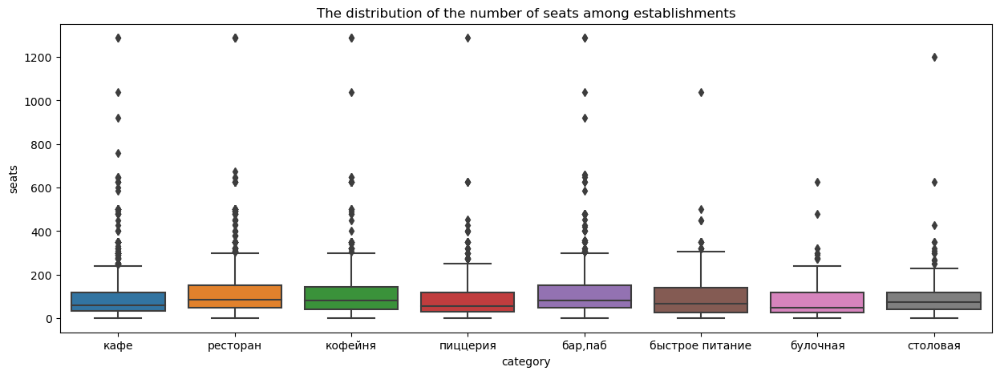

In [15]:
# The distribution of the number of seats among establishments of different categories.
fig, ax = plt.subplots(figsize=(15, 5))
 
ax = sns.boxplot(x='category', y='seats', data=data)
ax.set_title('The distribution of the number of seats among establishments');

In [16]:
# The determination of quantiles for the 'seats' column of the dataframe:
blowout = data['seats'].quantile([.95,.99]).reset_index()
blowout

,index,seats
0,0.95,307.0
1,0.99,625.0


**Conclusion**

The initial data contains information about the number of seats in 4795 food service facilities. For the remaining food service facilities, filling in the gaps is not possible, as the number of seats varies significantly even within the same category. 1% of all food service facilities have more than 625 seats, 5% have more than 307.

In addition, information is provided about food service facilities that belong to different categories ("restaurant", "cafe"), but in fact, they belong to the "banquet hall" category. For example, the Banquet Complex "Paradise" (address: Moscow, Marshal Zakharov Street, 6, Building 1) with a seating capacity of 675.

Furthermore, the initial data includes information about food courts, where the number of seats is calculated based on the number of food service facilities located there (usually 25-30 seats per food service facility in Moscow). Therefore, an abnormally large number of seats is not always outliers but represents the number of seats shared among multiple food service facilities, i.e., food courts.

Based on the research task, investors would like to open a cafe, restaurant, pizzeria, pub, or bar. There are no location restrictions (e.g., in a shopping center, park, etc.), so the number of seats in food courts should be evenly distributed among those food service facilities that have indicated the number of seats for the entire food court. I will identify the largest food courts considering that they host a minimum of 10 food service facilities and have more than 307 seats (which is 5% of all establishments).

As for banquet halls, there was no request from the client for them, and their number constitutes 1% of all food service facilities. Therefore, the largest banquet halls (with a capacity of 625 or more people) can be removed from the dataset.

In [17]:
# Search for food courts meeting specified criteria (a minimum of 10 food service facilities at one address and 250 seating places)
foodcourt = data.groupby(['address', 'seats'])['name'].nunique() 
foodcourt = foodcourt.reset_index()
foodcourt.columns  = ['address', 'seats', 'name_nunique']
foodcourt = foodcourt.query('name_nunique > 10 & seats > 307')
foodcourt['seats_middle'] = round(foodcourt['seats']/foodcourt['name_nunique'])
pd.set_option('display.max_colwidth', False)
foodcourt.head(20)

,address,seats,name_nunique,seats_middle
1038,"Москва, Лесная улица, 20, стр. 3",500.0,16,31.0
1488,"Москва, Пресненская набережная, 2",350.0,16,22.0
2332,"Москва, улица Вавилова, 3",320.0,14,23.0


In [18]:
# Replacing the total number of seats at the food court with median values depending on the number of food service facilities
for i in range(len(data['seats'])):
    for j in range(len(foodcourt['seats'])):
        if ((data['seats'].iloc[i] == foodcourt['seats'].iloc[j]) & (data['address'].iloc[i] == foodcourt['address'].iloc[j])).all():
            data['seats'].iloc[i] = foodcourt['seats_middle'].iloc[j]

C:\Users\Юлия\AppData\Local\Temp\ipykernel_43792\3605984724.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['seats'].iloc[i] = foodcourt['seats_middle'].iloc[j]


In [19]:
# Search for banquet halls with specified criteria (only one food service facility per address and more than 625 seating places)
banket = data.groupby('seats').agg({'address': 'unique','name': 'nunique', 'category': 'unique'})
banket = banket.query('name == 1 & seats > 625').reset_index()
pd.set_option('display.max_colwidth', False)
banket

,seats,address,name,category
0,675.0,"[Москва, улица Маршала Захарова, 6, корп. 1]",1,[ресторан]
1,760.0,"[Москва, улица Юности, 1]",1,[кафе]
2,1200.0,"[Москва, Кутузовский проспект, 41, стр. 1]",1,[столовая]


In [20]:
# Removing from the dataframe food service facilities that have banquet halls
data = data.drop(data[data.seats > 625].index)
data.isnull().sum()

name                 0   
category             0   
address              0   
district             0   
hours                529 
lat                  0   
lng                  0   
rating               0   
price                5069
avg_bill             4567
middle_avg_bill      5233
middle_coffee_cup    7842
chain                0   
seats                3611
street               0   
is_24_7              529 
dtype: int64

##  4. Data Analysis  <a class="anchor" id="fifth-bullet"></a>

### 4.1. Analysis of categories of food service facilities <a class="anchor" id="-fourth-first-bullet"></a>

In [21]:
print('Categories of public catering establishments:', data['category'].unique())

Categories of public catering establishments: ['кафе' 'ресторан' 'кофейня' 'пиццерия' 'бар,паб' 'быстрое питание'
 'булочная' 'столовая']


In [22]:
# сreating a pie chart for the distribution of the number of food service facilities in Moscow by categories
category_all = data.groupby('category')['address'].nunique()

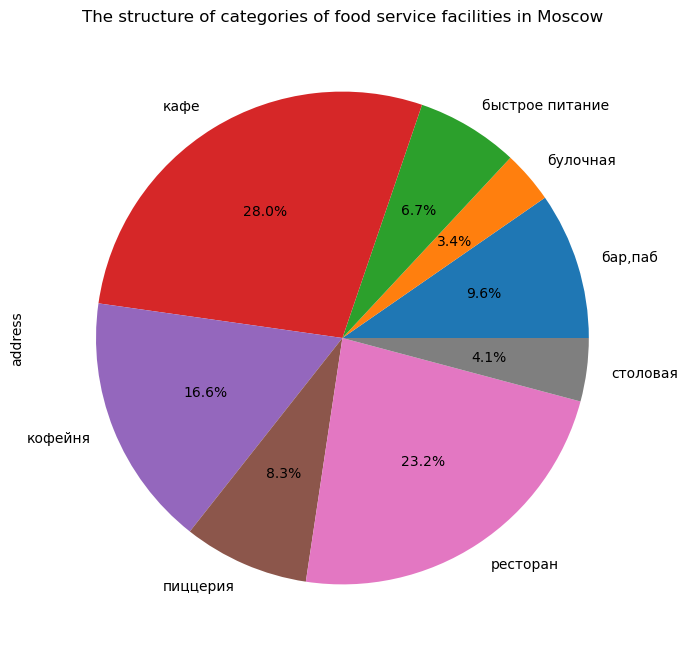

In [23]:
category_all.plot(y='address_nunique', kind = 'pie', autopct='%1.1f%%',
                     title = 'The structure of categories of food service facilities in Moscow',figsize=(8,8));


In [24]:
category_all = category_all.reset_index()
category_all.columns = ['category', 'address_nunique']
category_all = category_all.sort_values(by='address_nunique', ascending=False)
category_all

,category,address_nunique
3,кафе,2038
6,ресторан,1691
4,кофейня,1210
0,"бар,паб",702
5,пиццерия,601
2,быстрое питание,488
7,столовая,302
1,булочная,249


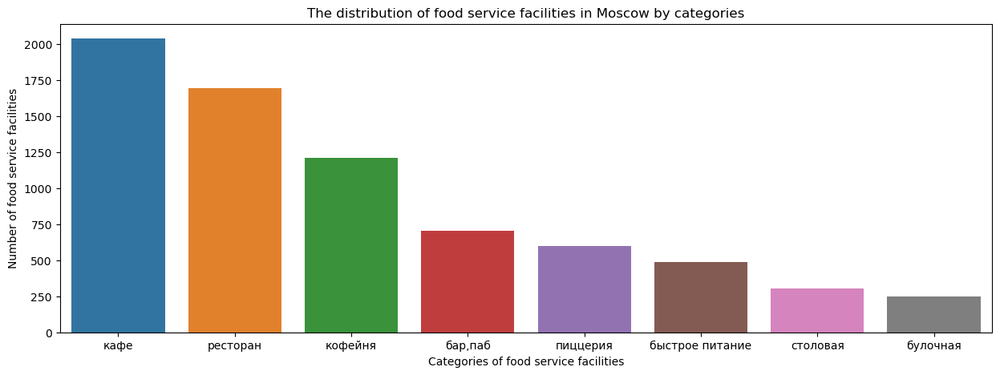

In [25]:
fig, ax = plt.subplots(figsize=(15, 5))
ax = sns.barplot(x='category', y='address_nunique', data=category_all) 
ax.set (xlabel='Categories of food service facilities',
 ylabel='Number of food service facilities',
 title='The distribution of food service facilities in Moscow by categories');

**Conclusion**

The initial data represents food service facilities in Moscow categorized as 'restaurant,' 'cafe,' 'pizzeria,' 'bar/pub,' 'fast food,' 'bakery,' 'canteen,' and 'coffee shop.'

The most common categories of food service facilities in Moscow are restaurants (1691 food service facilities) and cafes (2038 food service facilities), which account for 23.2% and 28% respectively. There are fewer bakeries and canteens, with 249 and 302 food service facilities (3.4% and 4.1% respectively).

### 4.2. Analysis of seating capacity in food service facilities <a class="anchor" id="-fourth-second-bullet"></a>

In [26]:
# descriptive statistics
data.groupby('category')['seats'].describe()

,count,mean,std,min,25%,50%,75%,max
category,,,,,,,,
"бар,паб",461.0,112.310195,101.335073,0.0,48.00,80.0,140.0,625.0
булочная,148.0,87.378378,95.951334,0.0,24.50,49.5,120.0,625.0
быстрое питание,348.0,91.425287,88.560519,0.0,23.75,60.0,130.0,450.0
кафе,1210.0,88.634711,90.839739,0.0,35.00,60.0,100.0,625.0
кофейня,746.0,100.997319,98.924485,0.0,38.00,75.0,140.0,625.0
пиццерия,426.0,90.924883,95.558342,0.0,30.00,52.0,120.0,625.0
ресторан,1263.0,111.364212,95.881830,0.0,48.00,83.0,150.0,625.0
столовая,163.0,93.000000,87.704048,0.0,40.00,75.0,116.0,625.0


In [27]:
seats_data = data.groupby('category')['seats'].median().reset_index().sort_values(by='seats', ascending=False)
seats_data

,category,seats
6,ресторан,83.0
0,"бар,паб",80.0
4,кофейня,75.0
7,столовая,75.0
2,быстрое питание,60.0
3,кафе,60.0
5,пиццерия,52.0
1,булочная,49.5


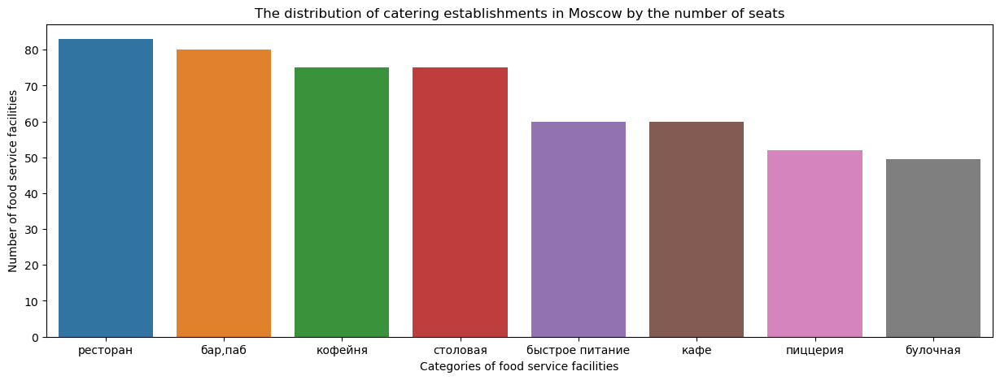

In [28]:
fig, ax = plt.subplots(figsize=(15, 5))
ax = sns.barplot(x='category', y='seats', data=seats_data) 
ax.set (xlabel='Categories of food service facilities',
 ylabel='Number of food service facilities',
 title='The distribution of catering establishments in Moscow by the number of seats');

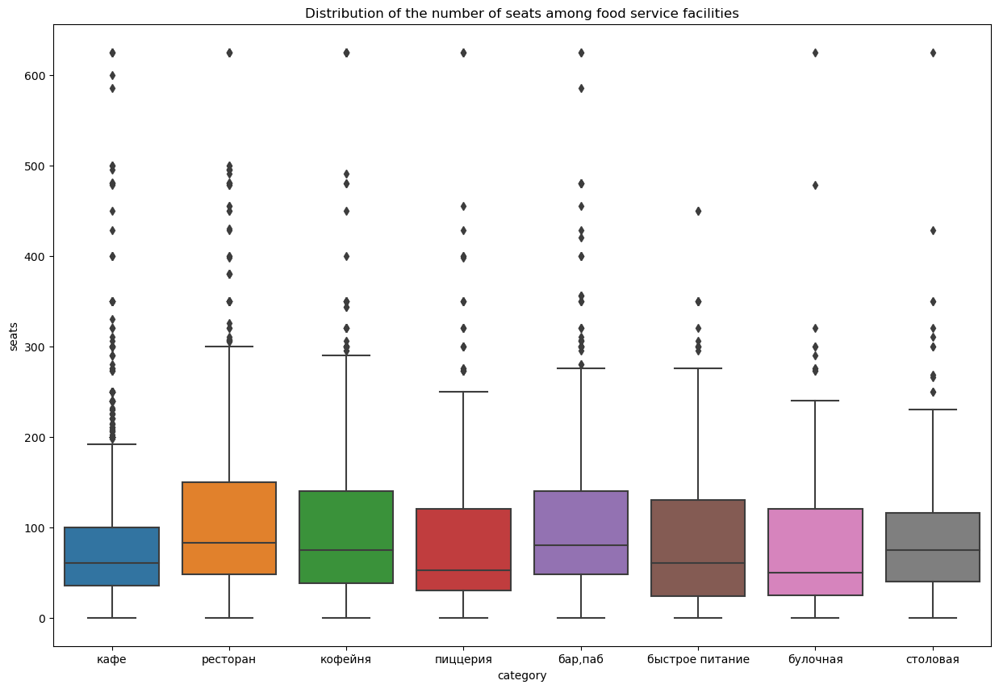

In [29]:
# The distribution graph with the number of seats among food service facilities of different categories
fig, ax = plt.subplots(figsize=(15, 10))
 
ax = sns.boxplot(x='category', y='seats', data=data)
ax.set_title('Distribution of the number of seats among food service facilities');

In [30]:
bake = data[data['category'] == 'булочная']
bake.head(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24_7
13,Буханка,булочная,"Москва, Базовская улица, 15, корп. 1",Северный административный округ,"ежедневно, 08:00–22:00",55.877007,37.504980,4.8,NaN,NaN,NaN,NaN,1,180.0,Базовская улица,False
19,Пекарня,булочная,"Москва, Ижорский проезд, 5",Северный административный округ,"ежедневно, круглосуточно",55.887969,37.515688,4.4,NaN,NaN,NaN,NaN,1,NaN,Ижорский проезд,True
23,Буханка,булочная,"Москва, Лобненская улица, 13к2",Северный административный округ,"ежедневно, 08:00–22:00",55.888421,37.527106,4.7,NaN,NaN,NaN,NaN,1,NaN,Лобненская улица,False
30,Кафедра,булочная,"Москва, Базовская улица, 15, корп. 6",Северный административный округ,"ежедневно, 08:00–21:00",55.879723,37.510227,4.4,NaN,NaN,NaN,NaN,0,NaN,Базовская улица,False
38,Ижора,булочная,"Москва, Ижорский проезд, 5А",Северный административный округ,NaN,55.888366,37.514856,4.4,NaN,NaN,NaN,NaN,0,NaN,Ижорский проезд,NaN


**Conclusion**

The weighted average number of seats in public catering establishments in Moscow ranges from 50 to 83 seats depending on the category of the food service facilities. 

From the graphs, it can be concluded that the number of seats may not depend on the category of the food service facilities: there are large coffee shops and small restaurants. However, the category of the food service facility may not always have been indicated correctly, or the food service facility may belong to several categories at once, which explains why the average number of seats does not vary significantly by category. For example, the median number of seats in restaurants is 83 (the leader among food service facilities in terms of the number of seats), and in bars and pubs, it is 80, which can be explained by the fact that bars can also have banquet halls, i.e., be designed for a large number of visitors.

Regarding the correct filling of the category, it is worth noting that errors were possible both in specifying the category of the food service facility and in the number of seats. For example, for the category 'Kebab' (Moscow, Abramtsevskaya Street, 1), the category indicated is 'bakery,' and the number of seats is 240, as for a large restaurant.

In connection with the above, the presented information on the distribution of seats by categories of food service facilities should be treated with caution.

### 4.3. Analysis of food service facilities in terms of belonging to networks <a class="anchor" id="-fourth-third-bullet"></a>

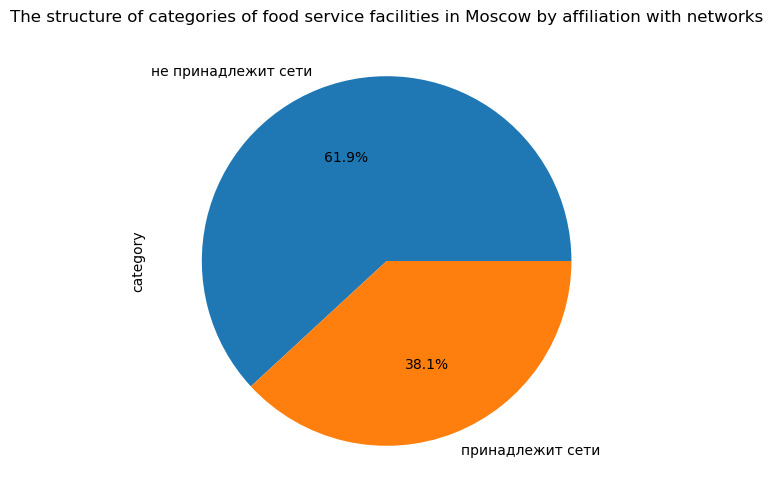

In [31]:
# Creating an additional dataframe for a comparative analysis 
# of the structure of food service facilities based on their affiliation with restaurant chains
chain_structure = data
chain_structure['chain'] = chain_structure['chain'].astype(object)

chain_structure.loc[chain_structure['chain'] == 0, 'chain'] = 'не принадлежит сети'
chain_structure.loc[chain_structure['chain'] == 1, 'chain'] = 'принадлежит сети'


chain_structure_total = chain_structure.groupby('chain')['category'].count()
chain_structure_total.plot(y='category', kind = 'pie', autopct='%1.1f%%',
                     title = 'The structure of categories of food service facilities in Moscow by affiliation with networks',figsize=(6,6));


In [32]:
# creating a DataFrame for the chart 'Distribution of food service facilities in Moscow by categories and networks'
chain_structure_category = chain_structure.groupby(['category','chain']).agg({'address': 'count'})\
.reset_index().sort_values(by='address', ascending=False)

fig = px.bar(chain_structure_category, x='category', y = 'address', color='chain', text = 'address', \
             title='The distribution of food service facilities in Moscow by categories and chains')
fig.update_xaxes(tickangle=45)

fig.update_yaxes(title='Number of food service facilities')
fig.update_xaxes(title='Category of food service facilities')
fig.show();

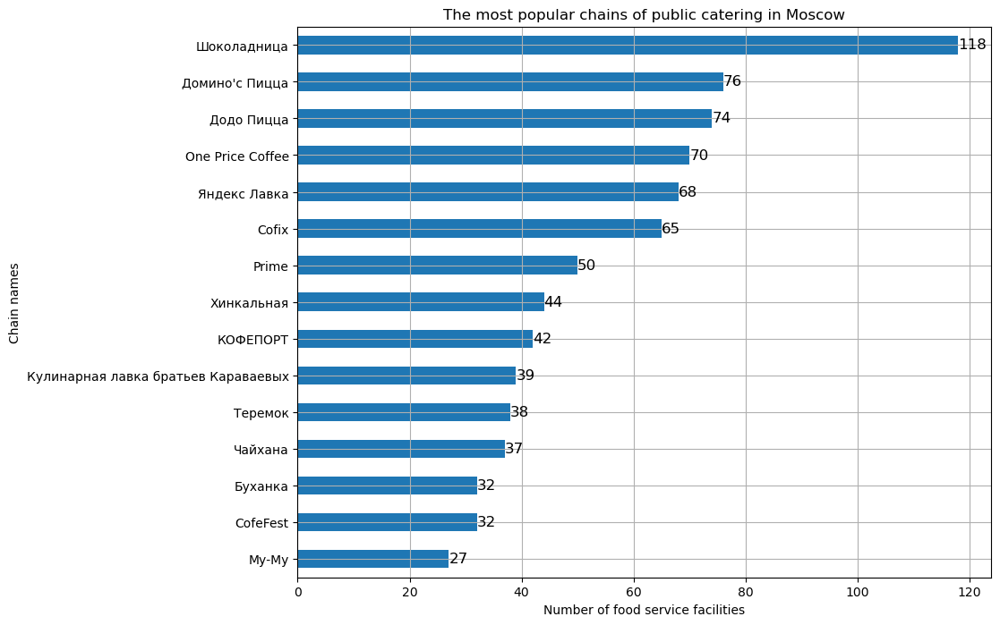

In [33]:
# List of the top 15 chains of public catering in Moscow
top_15 = chain_structure.query('chain == "принадлежит сети"').groupby('name').agg({'address': 'count', 'category':'unique'})
top_15 = top_15.reset_index().sort_values(by='address', ascending = False).head(15) 


# The graph depicting the relationship between the price and the floor level of the apartment listed for sale
ax = top_15.pivot_table(index='name',values='address').sort_values(by='address', ascending = True)\
.plot(kind='barh', figsize=(10,8), legend=False)

# Add labels to each column
for p in ax.patches: 
    ax.text(p.get_width(), p.get_y() + p.get_height()/2,  
            '%d' % int(p.get_width()),   
            fontsize=12, color='Black', ha='left', va='center')

# Network names
ax.set_title('The most popular chains of public catering in Moscow') 
ax.set_xlabel('Number of food service facilities') 
ax.set_ylabel('Chain names') 
ax.grid(True) 

plt.show()

In [34]:
top_15.reset_index(drop= True, inplace= True)
top_15

,name,address,category
0,Шоколадница,118,"[кофейня, кафе]"
1,Домино'с Пицца,76,[пиццерия]
2,Додо Пицца,74,[пиццерия]
3,One Price Coffee,70,[кофейня]
4,Яндекс Лавка,68,[ресторан]
5,Cofix,65,[кофейня]
6,Prime,50,"[ресторан, кафе]"
7,Хинкальная,44,"[быстрое питание, кафе, ресторан, столовая, бар,паб]"
8,КОФЕПОРТ,42,[кофейня]
9,Кулинарная лавка братьев Караваевых,39,[кафе]


**Conclusion**

Based on the provided data, the share of food service facilities belonging to both chains and independent ones is 38.1% and 61.9%, respectively. Restaurants, cafes, and coffee shops are most commonly part of chains. The leaders among the most common chains are "Shokoladnitsa" (118 food service facilities), Domino's Pizza (76 food service facilities), and Dodo Pizza (74 food service facilities), which in the first case fall into the "coffee shop, cafe" category, while in the second and third cases, they are pizzerias. 

Following them with a slight lag are the chains One Price Coffee and Cofix. As a promising direction, Yandex Lavka (a service for ordering groceries and household goods from local warehouses via a mobile app or website) stands out.

### 4.4. Analysis of food service facilities relative to their geographical location  <a class="anchor" id="-fourth-fourth-bullet"></a>

In [35]:
print('"Administrative districts of Moscow"')
print()
print(data['district'].unique())


"Administrative districts of Moscow"

['Северный административный округ'
 'Северо-Восточный административный округ'
 'Северо-Западный административный округ'
 'Западный административный округ' 'Центральный административный округ'
 'Восточный административный округ' 'Юго-Восточный административный округ'
 'Южный административный округ' 'Юго-Западный административный округ']


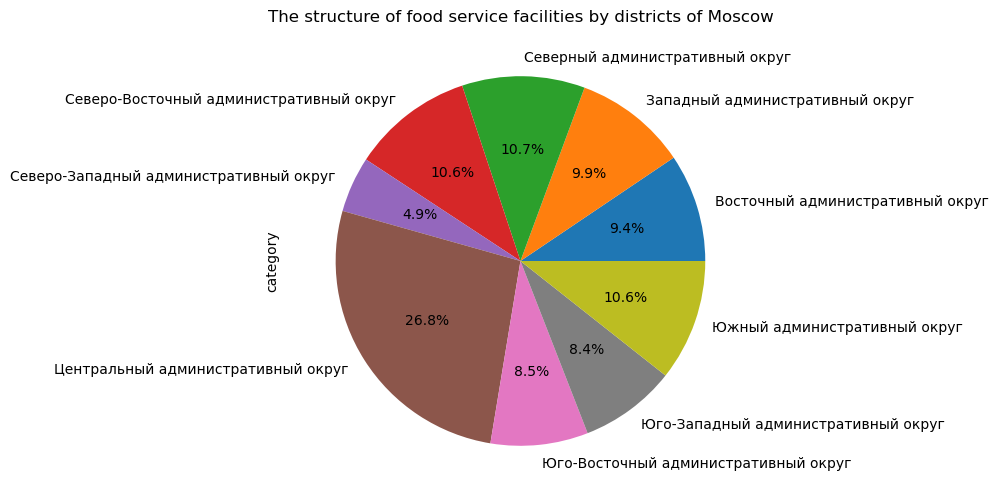

In [36]:
# creating an additional dataframe for comparative analysis of the structure of food service facilities 
# by affiliation to administrative districts of Moscow city
district_total = data.groupby('district')['category'].count()
district_total.plot(y='district', kind = 'pie', autopct='%1.1f%%',
                     title = 'The structure of food service facilities by districts of Moscow',figsize=(6,6));


In [37]:
# creating an additional dataframe for comparative analysis of food service facilities' 
# structure by categories and affiliation with administrative districts in Moscow

district_structure = data.groupby(['district', 'category'])['address'].count()
district_structure = district_structure.reset_index()

# creating an additional dataframe to reflect on the graph the total number 
# of food service facilities by affiliation to the administrative districts of Moscow city

district_total = district_structure.groupby('district')['address'].sum().reset_index()
fig = px.bar(district_structure, x="district", y="address", color="category", text = 'address', height=800,\
            title='The distribution of food service facilities in Moscow by categories and districts')
fig.add_trace(px.line(district_total, x='district', y='address', text = 'address').data[0]) 
fig.update_yaxes(title='Number of food service facilities')
fig.update_xaxes(title='The administrative districts of Moscow')
fig.show();


**Conclusion:**
In the Central Administrative District, there are 2242 food service facilities, which make up 26.8% of all food service facilities in Moscow. The lowest number of food service facilities is in the North-Western Administrative District (4.9% or 409 food service facilities). In the other administrative districts, there are approximately 10% of all other food service facilities each.

The graph shows that the most common category of food service facilities in almost all districts is "cafe," with the highest number in the Central Administrative District - 464 food service facilities. It is also worth noting that in the Central Administrative District, restaurants are the most common category of food service facilities, which can be explained by the large number of entertainment events for residents and visitors of the capital, as well as offices.

### 4.5. Analysis of food service facilities by rating <a class="anchor" id="-fourth-fifth-bullet"></a>

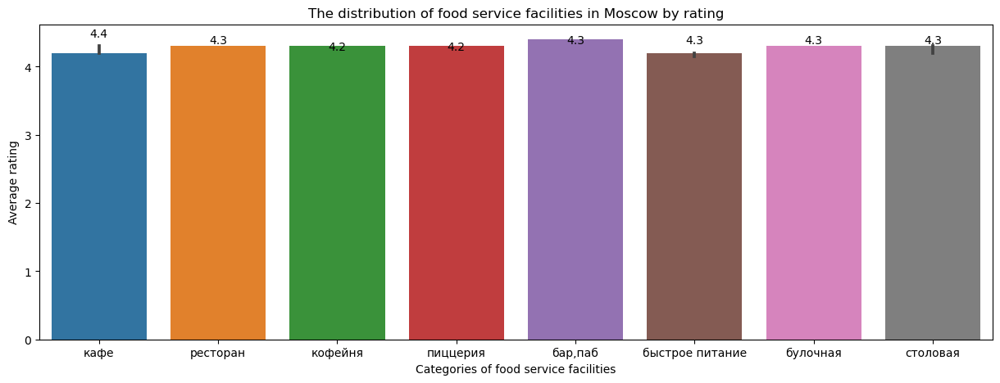

In [38]:
# Visualization of average ratings by food service facilities categories
fig, ax = plt.subplots(figsize=(15, 5))
ax = sns.barplot(x='category', y='rating', data=data, estimator=median)

# Calculating median values
medians = data.groupby('category')['rating'].median()

# Adding labels with median values to the chart
for i, median in enumerate(medians):
    ax.annotate(f'{median}', xy=(i, median), ha='center', va='bottom')

ax.set (xlabel='Categories of food service facilities',
 ylabel='Average rating',
 title='The distribution of food service facilities in Moscow by rating');

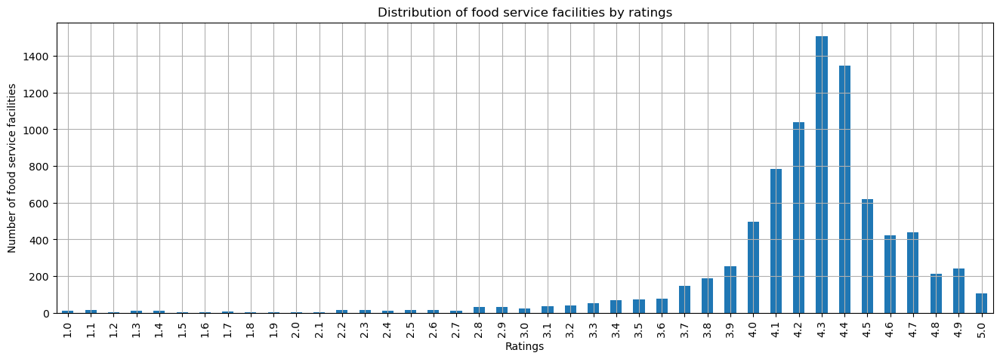

In [39]:
data.groupby('rating')['address'].count().plot(kind = 'bar', 
    figsize=(16,5), title='Distribution of food service facilities by ratings', grid='True')
plt.xlabel('Ratings')
plt.ylabel('Number of food service facilities')
plt.show()

In [40]:
rating = data.groupby('district', as_index=False)['rating'].median()
rating

,district,rating
0,Восточный административный округ,4.3
1,Западный административный округ,4.3
2,Северный административный округ,4.3
3,Северо-Восточный административный округ,4.2
4,Северо-Западный административный округ,4.3
5,Центральный административный округ,4.4
6,Юго-Восточный административный округ,4.2
7,Юго-Западный административный округ,4.3
8,Южный административный округ,4.3


In [41]:
import json
# Reading the file and save it in a variable.
with open('admin_level_geomap.geojson', 'r') as f:
    geo_json = json.load(f)

In [42]:
# import the map and thr choropleth

from folium import Marker, Map, Choropleth
# loading a JSON file with the boundaries of Moscow districts
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'

# moscow_lat - latitude of the center of Moscow, moscow_lng - longitude of the center of Moscow
moscow_lat, moscow_lng = 55.751244, 37.618423

# creating a map of Moscow
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

In [43]:
# Creating a choropleth using the Choropleth constructor and adding it to the map
Choropleth(
    geo_data=state_geo,
    data=rating,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='The median rating of food service facilities by districts of Moscow',
).add_to(m);
m

In [44]:
# import Cluster
from folium.plugins import MarkerCluster

# moscow_lat - latitude of the center of Moscow, moscow_lng - longitude of the center of Moscow
moscow_lat, moscow_lng = 55.751244, 37.618423

# creating a map of Moscow
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# creating an empty cluster and add it to the map
marker_cluster = MarkerCluster().add_to(m)

# function that takes a dataframe string, 
# creating a marker at the current point, and adding it to the marker cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# applying the create_clusters() function to each row of the dataframe
data[:len(data['district'])].apply(create_clusters, axis=1)

# showing a map
m


**Conclusion**

Food service facilities in Moscow have almost the same rating regardless of the category they belong to. However, depending on the district, the rating also changes slightly: food service facilities with the highest ratings are located in the Central Administrative District (4.4), while those with the lowest ratings are in the Southeastern Administrative District and the Northeastern Administrative District (4.2). Most food service facilities have a rating between 4 and 4.7.

### 4.6.  The streets where only one food service facility is located  <a class="anchor" id="-fourth-sixes-bullet"></a>

In [45]:
# Selecting streets with only one foodservice facility
one_street = data.groupby('street')['name'].count().reset_index().sort_values(by='name').head(15)

In [46]:
one_street = one_street['street']
# 
one_street_data = data.query('street in @one_street')

In [47]:
print('The categories of food service facilities located on the selected streets', one_street_data['category'].unique())

The categories of food service facilities located on the selected streets ['ресторан' 'столовая' 'кофейня' 'бар,паб' 'кафе']


In [48]:
# creating a map of Moscow
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# function that takes a dataframe string, 
# creating a marker at the current point, and adding it to the marker cluster
def create_marker(row):
    Marker([row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}"
    ).add_to(m)

# applying the create_clusters function to each row of the dataframe
one_street_data.apply(create_marker, axis=1)
    
# showing a map
m

In [49]:
# creating an additional dataframe for a comparative analysis of food service facilities by categories 
# and affiliation with administrative districts of Moscow
one_street_data = one_street_data.groupby('district').agg({'name': 'count', 'rating': 'median'})
one_street_data = one_street_data.reset_index()

fig = px.bar(one_street_data, x="district", y="name", color="rating", text = 'rating', height=500,\
            title='The distribution of food service facilities in Moscow by categories and districts')

fig.update_yaxes(title='The number of food service facilities')
fig.update_xaxes(title='The administrative districts of Moscow')
fig.show();


**Conclusion**

The categories of food service facilities located on the selected streets include 'restaurant,' 'cafeteria,' 'coffee shop,' 'bar/pub,' and 'cafe,' with the majority of them (5 establishments) located in the Central Administrative District and having high ratings. The lowest ratings are found in food service facilities in the Southeastern Administrative District and Southern Administrative District.

On the map, it can be observed that streets with only one food service facility are generally located in areas geographically distant from the center of Moscow.

Overall, the sample based on the specified criteria confirms the trends identified earlier from the analysis of the entire dataset.

### 4.7. Analysis of average restaurant bills <a class="anchor" id="-fourth-sevens-bullet"></a>

In [50]:
# Determining the price indicator for each district
middle_avg_bill = data.groupby('district', as_index=False)['middle_avg_bill'].median()

In [51]:
# Creating a choropleth map using the Choropleth constructor and adding it to the map
Choropleth(
    geo_data=state_geo,
    data=middle_avg_bill,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='The price indicator of food service facilities by districts of Moscow',
).add_to(m)
m

In [52]:
middle_avg_bill = middle_avg_bill.sort_values(by='middle_avg_bill', ascending=False)
middle_avg_bill

,district,middle_avg_bill
1,Западный административный округ,1000.0
5,Центральный административный округ,1000.0
4,Северо-Западный административный округ,700.0
2,Северный административный округ,650.0
7,Юго-Западный административный округ,600.0
0,Восточный административный округ,550.0
3,Северо-Восточный административный округ,500.0
8,Южный административный округ,500.0
6,Юго-Восточный административный округ,450.0


**Conclusion**

The median value of all food service facilities in Moscow ranges from 450 to 1000 rubles. Of course, the maximum average bill is in the Central Administrative District and Western Administrative District (1000 rubles), while the minimum average bill is in the Southeastern Administrative District (450 rubles). The farther from the center, the cheaper it gets, especially noticeable in the southeastern direction.

#### 4.7. The additional analysis

In [53]:
# Rating indicator determination for each district (for food service facilities with poor ratings)
bad_rating = data.query('rating < 3').groupby('district', as_index=False)['address'].count()
bad_rating.sort_values(by='address')

,district,address
5,Центральный административный округ,6
4,Северо-Западный административный округ,11
8,Южный административный округ,16
2,Северный административный округ,17
0,Восточный административный округ,21
7,Юго-Западный административный округ,23
1,Западный административный округ,32
3,Северо-Восточный административный округ,35
6,Юго-Восточный административный округ,49


In [54]:
# Creating a choropleth using the Choropleth constructor and adding it to the map
Choropleth(
    geo_data=state_geo,
    data=bad_rating,
    columns=['district', 'address'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='The rating indicator of food service facilities with low ratings by Moscow districts',
).add_to(m)
m

Most food service facilities with poor ratings (<3) are located in the Southeastern Administrative District of Moscow, namely 49 food service facilities. In the Central Administrative District, there are almost no food service facilities with poor ratings.

In [55]:
# Definition of the average check indicator for each district (for food service facilities with low ratings
middle_avg_bill_bad_rating = data.query('rating < 3').groupby('district', as_index=False)['middle_avg_bill'].median()
middle_avg_bill_bad_rating.sort_values(by='middle_avg_bill')

,district,middle_avg_bill
6,Юго-Восточный административный округ,237.5
0,Восточный административный округ,290.0
7,Юго-Западный административный округ,325.0
8,Южный административный округ,470.0
5,Центральный административный округ,600.0
3,Северо-Восточный административный округ,700.0
2,Северный административный округ,900.0
1,Западный административный округ,1000.0
4,Северо-Западный административный округ,1100.0


In [56]:
# Creating a choropleth using the Choropleth constructor and adding it to the map
Choropleth(
    geo_data=state_geo,
    data=middle_avg_bill_bad_rating,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='The price indicator of establishments with low ratings by districts of Moscow',
).add_to(m)
m

For food service facilities with low ratings, the median value of average checks differs for each district. The highest indicator is for food service facilities in the Northwestern Administrative District (1100 rubles), while the lowest is in the Southeastern Administrative District (237.5 rubles). Based on these indicators, it can be assumed that the average check depends on the district where the food service facility is located. I will create a graph illustrating the relationship between the average check and categories by districts of Moscow, using the most common category as an example, 'cafe'.

In [57]:
# Defining the distribution indicator for each district (for establishments with low ratings)
category_bad_rating = data.query('rating < 3 & category == "кафе"').groupby('district', as_index=False).agg({'address' : 'count'})
category_bad_rating.sort_values(by='address')

,district,address
5,Центральный административный округ,3
2,Северный административный округ,7
4,Северо-Западный административный округ,9
8,Южный административный округ,9
0,Восточный административный округ,12
1,Западный административный округ,15
3,Северо-Восточный административный округ,16
7,Юго-Западный административный округ,16
6,Юго-Восточный административный округ,20


In [58]:
# Creating a choropleth map using the Choropleth constructor and adding it to the map
Choropleth(
    geo_data=state_geo,
    data=category_bad_rating,
    columns=['district', 'address'],
    key_on='feature.name',
    fill_color='YlGn',
    fill_opacity=0.8,
    legend_name='The distribution of "cafe" establishments with low ratings by districts of Moscow'
).add_to(m)
m

Based on the graph, it can be concluded that the majority of cafes with low ratings are also located in the Southeastern Administrative District of Moscow (20 food service facilities), while the fewest are found in the Central Administrative District (3 food service facilities).

### 4.8. Summary of the fourth section <a class="anchor" id="-fourth-eightss-bullet"></a>

This data presents food service facilities in Moscow by categories: 'restaurant', 'cafe', 'pizzeria', 'bar, pub', 'fast food', 'bakery', 'canteen', 'coffee shop'.

The most common categories of food service facilities in Moscow are restaurants (1691 food service facilities) and cafes (2038 food service facilities), which account for 23.2% and 28% respectively. The fewest are bakeries and canteens - 249 and 302 (3.4% and 4.1% respectively).

The weighted average number of seats in food service facilities in Moscow ranges from 50 to 83, depending on the category of food service facilities. From the graphs, it can be concluded that the number of seats may not depend on the category of the food service facility: there are large coffee shops and small restaurants. At the same time, the category of the food service facilities may not always have been indicated correctly, or the food service facility may belong to several categories, which explains why the average number of seats does not vary significantly by category. For example, the median number of seats in restaurants is 83 (the leader among food service facilities in terms of the number of seats), and in bars and pubs, it is 80, which can be explained by the fact that bars may also have banquet halls, i.e., be designed for a large number of visitors.

Regarding the correct filling of the category of the food service facilities, it should be especially noted that in the case of specifying the category of the food service facilities 'Kebab(Shashlik)' (Moscow, Abramtsevskaya Street, 1), the category 'bakery' is indicated, and the number of seats is 240, as for a large restaurant.

In connection with the above, information about the distribution of seats by categories of food service facilities should be treated with caution.

Based on the presented data, the share of food service facilities belonging and not belonging to networks is 38.1% and 61.9%, respectively. Most often, restaurants, cafes, and coffee shops are part of networks. The leaders among the most common networks are "Shokoladnitsa" (118 food service facilities), Domino's Pizza (76 food service facilities), Dodo Pizza (74 food service facilities), which in the first case belong to the category "coffee shop, cafe," and in the second and third cases - pizzerias. Next, with a slight lag, are the coffee shop chains One Price Coffee and Cofix. The Yandex Lavka (a service for ordering groceries and household goods for home delivery from local warehouses through a mobile application or website) is highlighted as a promising direction.

In the Central Administrative District, there are 2242 food service facilities or 26.8% of all food service facilities in Moscow. The minimum number of food service facilities is in the Northwestern Administrative District (4.9% or 409 food service facilities). In the other administrative districts, there are approximately 10% of all other food service facilities each.

The most common category of food service facilities in almost all districts is 'cafe', with the highest number in the Central Administrative District - 464 food service facilities. It is also worth noting that in the Central Administrative District, the most common category of food service facilities is restaurants, which can be explained by the large number of entertainment events for residents and guests of the capital, as well as offices.

Food service facilities in Moscow have almost the same rating regardless of the category they belong to. At the same time, depending on the district, the rating also varies slightly: food service facilities with the highest ratings are located in the Central Administrative District (4.4), while those with the lowest are in the Southern Administrative District (4.2).

The median value of all food service facilities in Moscow ranges from 450 to 1000 rubles. Of course, the maximum average bill is in the Central Administrative District and Western Administrative District (1000 rubles), while the minimum average bill is in the Southeastern Administrative District (450 rubles). The further from the center, the cheaper it is. This is especially noticeable in the southeast direction.

Most food service facilities with poor ratings (<3) are located in the Southeastern Administrative District of Moscow, i.e., 49 food service facilities. There are practically no food service facilities with poor ratings in the Central Administrative District.

##  5. Detailed research: a coffe shop opening  <a class="anchor" id="fives-bullet"></a>

### 5.1. The number of coffe shops in the provided data.  <a class="anchor" id="-fifth-first-bullet"></a>

In [59]:
print('The number of coffe shops in Moscow:', data.query('category == "кофейня"')['address'].count())

The number of coffe shops in Moscow: 1408


### 5.2. The list of districts in Moscow where most coffe shops are located, and the features of their distribution  <a class="anchor" id="-fifth-second-bullet"></a>

In [60]:
print('The list of districts in Moscow where most coffe shops are located:"')
print(data.query('category == "кофейня"').groupby('district', as_index=False)['address'].\
      count().sort_values(by='address', ascending=False).head(3).reset_index(drop=True))

The list of districts in Moscow where most coffe shops are located:"
                                  district  address
0  Центральный административный округ       428    
1  Северный административный округ          193    
2  Северо-Восточный административный округ  159    


In [61]:
# creating a dataframe with coffe shops in Moscow
coffe_shop = data.query('category == "кофейня"').dropna(subset=['rating'])

In [62]:
# import the map and marker
from folium import Map, Marker
# import the cluster
from folium.plugins import MarkerCluster

# moscow_lat - latitude of the center of Moscow, moscow_lng - longitude of the center of Moscow
moscow_lat, moscow_lng = 55.751244, 37.618423

# creating a map of Moscow
m = Map(location=[moscow_lat, moscow_lng], zoom_start=10)
# creating an empty cluster and add it to the map
marker_cluster = MarkerCluster().add_to(m)

# a function that takes a dataframe string, creates a marker at the current point, 
# and adds it to the marker cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# calling the function create_clusters() for each row of the dataframe
coffe_shop[:len(coffe_shop['name'])].apply(create_clusters, axis=1)

# showing a map
m


**Conclusion**

The number of coffee shops in Moscow is 1408, with the majority of them located in the Central Administrative District (428 food service facilities), the Northern Administrative District (193 food service facilities), and the Northeastern Administrative District (159 food service facilities). 

The highest density of coffee shops is in the Central Administrative District, with the highest concentration along the Garden Ring. In the Northern Administrative District and the Northeastern Administrative District, coffee shops are located near metro stations, shopping centers, and parks. For example, in the Western Administrative District, there are 32 establishments in the 'Golovinsky' district and 43 establishments in the 'Sokol' district. In the Northern Administrative District, there is the 'Savelovski' district. The closer to the Garden Ring, the higher the density of cafe placement.

###  5.3. The list of 24-hour coffe shops  <a class="anchor" id="-fifth-third-bullet"></a>

In [63]:
print('The list of 24-hour coffe shops:')

data.query('category == "кофейня" & is_24_7 == True').groupby('name')['address'].unique().reset_index()

The list of 24-hour coffe shops:


,name,address
0,Cinnabon,"[Москва, Долгоруковская улица, 40]"
1,Cofix,"[Москва, Комсомольская площадь, 3, Москва, Центральный административный округ, Красносельский район, Каланчёвская улица, 11с1]"
2,FoodMoscowCoffee,"[Москва, Ленинский проспект (дублёр)]"
3,One And Double,"[Москва, площадь Киевского Вокзала, 1]"
4,One Price Coffee,"[Москва, Комсомольская площадь, 3]"
5,"One more, please","[Москва, Новочерёмушкинская улица, 58]"
6,One&Double,"[Москва, Павелецкая площадь, 1А, стр. 1]"
7,The wild bean cafe,"[Москва, проспект Вернадского, 86Д]"
8,Wild Bean,"[Москва, Дмитровское шоссе, 107Е, Москва, МКАД, 60-й километр, 4Бс1, Москва, Рублёвское шоссе, 91А, Москва, МКАД, 41-й километр, 18, стр. 1, Москва, Ясеневая улица, 13]"
9,Wild Bean Cafe,"[Москва, Ярославское шоссе, 116, Москва, Ярославское шоссе, вл3с3, Москва, МКАД, 65-й километр, 8, Москва, Бутырская улица, 8А, Москва, Ленинский проспект, 137Ас1, Москва, Люблинская улица, 135/1с1]"


In [64]:
print('The number of 24-hour coffee shops in Moscow:')
print(data.query('category == "кофейня" & is_24_7 == True')['address'].count())

The number of 24-hour coffee shops in Moscow:
59


### 5.4. Ratings  of coffee schops in Moscow  <a class="anchor" id="-fifth-fourth-bullet"></a>

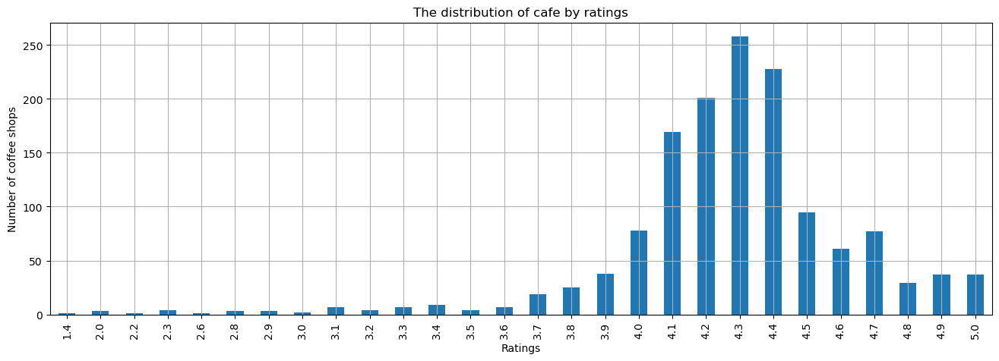

In [65]:
data.query('category == "кофейня"').groupby('rating')['address'].count().plot(kind = 'bar', 
    figsize=(16,5), title='The distribution of cafe by ratings', grid='True')
plt.xlabel('Ratings')
plt.ylabel('Number of coffee shops')
plt.show()

**Conclusion **

The majority of coffee shops have ratings between 4.0 and 4.7. 
In particular, coffee shops with a rating of 4.3 are the most common, with over 250 of them.

###  5.5. The distribution of coffee shops ratings by districts  <a class="anchor" id="-fifth-fifth-bullet"></a>

In [66]:
print(data.query('category == "кофейня"').groupby('district')['rating'].median().reset_index())


                                  district  rating
0  Восточный административный округ         4.3   
1  Западный административный округ          4.2   
2  Северный административный округ          4.3   
3  Северо-Восточный административный округ  4.3   
4  Северо-Западный административный округ   4.3   
5  Центральный административный округ       4.3   
6  Юго-Восточный административный округ     4.3   
7  Юго-Западный административный округ      4.3   
8  Южный административный округ             4.3   


In [67]:
koffee_shop_district = data.query('category == "кофейня"').groupby(['district', 'rating'])['address'].count().reset_index()

In [68]:
fig = px.bar(koffee_shop_district, x='district', y='rating', text='address', color='rating', title='The distribution of coffee shop ratings by districts', height=800)
fig.update_yaxes(title='Number of food service facilities')
fig.update_xaxes(title='Administrative districts of Moscow')
fig.show();

**Conclusion**

In general, there are very few coffee shops with low ratings; most coffee shops have ratings higher than 4. 

The median rating for all districts is almost the same (4.3), except for the Western Administrative District of Moscow (4.2).

### 5.6. The optimal cost of a cappuccino cup upon opening a coffee shop.  <a class="anchor" id="-fifth-sixth-bullet"></a>

In [69]:
# the median price of a cappuccino cup by districts of Moscow
print(data.query('category == "кофейня"').groupby(['district'])['middle_coffee_cup'].median().reset_index())

                                  district  middle_coffee_cup
0  Восточный административный округ         135.0            
1  Западный административный округ          187.0            
2  Северный административный округ          159.0            
3  Северо-Восточный административный округ  162.5            
4  Северо-Западный административный округ   165.0            
5  Центральный административный округ       190.0            
6  Юго-Восточный административный округ     147.5            
7  Юго-Западный административный округ      198.0            
8  Южный административный округ             150.0            


In [70]:
# Creating a dataframe with the distribution of the median price 
# of a cappuccino cup by districts of Moscow and depending on the rating
middle_coffee_cup_data = data.query('category == "кофейня"').dropna(subset=['middle_coffee_cup'])
middle_coffee_cup_data = middle_coffee_cup_data.groupby(['district', 'rating'])['middle_coffee_cup'].median().reset_index()


In [71]:
fig = px.bar(middle_coffee_cup_data, x='district', y='rating', text='middle_coffee_cup', color='rating', \
             title='The distribution of the median price of a cappuccino cup based on ratings and districts of Moscow.', height=800)
fig.update_yaxes(title='the cost of a cappuccino')
fig.update_xaxes(title='Administrative districts of Moscow')
fig.show();

### 5.7. Recommendations for opening a new coffee shop <a class="anchor" id="-fifth-seventh-bullet"></a>

To determine the optimal price for a cappuccino cup when opening a coffee shop, it is necessary to calculate the median value of cappuccino cup prices at competitor coffee shops, taking into account their ratings and geographical locations.

You should focus on coffee shops with a rating of at least 4 points. A high rating indicates how well the quality of service matches the price.

I will create a chart similar to the previous one, that is, the dependence of the cost of a cappuccino for coffee shops with high ratings on the geographical location.

In [72]:
# Creating a dataframe with the distribution of the median price of a cappuccino cup 
# by Moscow city districts and depending on the rating.
best_coffee_cup_data = data.query('category == "кофейня"').dropna(subset=['middle_coffee_cup'])
best_coffee_cup_data = best_coffee_cup_data.query('rating > 4').groupby(['district'])['middle_coffee_cup'].\
median().reset_index().sort_values(by='middle_coffee_cup', ascending=False)
best_coffee_cup_data

,district,middle_coffee_cup
1,Западный административный округ,225.0
7,Юго-Западный административный округ,199.0
5,Центральный административный округ,192.5
4,Северо-Западный административный округ,174.0
3,Северо-Восточный административный округ,170.0
8,Южный административный округ,170.0
2,Северный административный округ,161.0
6,Юго-Восточный административный округ,147.5
0,Восточный административный округ,135.0


In [73]:
fig = px.bar(best_coffee_cup_data, x='district', y='middle_coffee_cup', text='middle_coffee_cup', \
             title='The distribution of the median price of a cappuccino cup in the best coffee shops by districts of Moscow', height=600)
fig.update_yaxes(title='the cost of a cappuccino')
fig.update_xaxes(title='Administrative districts of Moscow')
fig.show();

**Opening a Coffee Shop Suggestions**

To actively attract visitors during the coffee shop's opening phase, the optimal price for a cup of cappuccino is suggested to be determined as follows.

Depending on the geographical location of the coffee shop, you need to establish the average price of a cup of cappuccino in the best coffee shops in Moscow (for example, for the Western Administrative District of Moscow, it will be 225 rubles). Then, either set the same price or reduce it (for example, by 20% or to 180 rubles) depending on the chosen customer attraction policy.

If you plan to open a coffee shop in the districts of Moscow with the lowest income levels (Eastern Administrative District, Southeastern Administrative District), it can be assumed that here the price of a cup of cappuccino (135 rubles and 147.5 rubles) reflects the pricing policy of food service facilities. Network establishments or those willing to maximize cost reduction at the expense of service quality can afford a pricing policy of this kind. When opening a new food service facility, it initially operates on reputation - this is quality plus a slightly lower price compared to competitors because customers will not initially visit a new food service facility with low levels of service.

##  The presentation  <a class="anchor" id="sixes-bullet"></a>

[Link to the presentation](Restaurants.pdf)